# Finding Lane Lines on the Road

## Project Overview
This project aims to develop a computer vision system capable of detecting and tracking lane lines on the road in real-time. Using Python and OpenCV, this project applies various image processing techniques to identify lane lines and detect vehicles from dash-cam video footage.

## Goals
- **Detect lane lines** using image processing techniques.
- **Track lane lines** in real time on video data.
- **Enhance detection** under varying lighting and road conditions.

## Technologies Used
- **Python:** Main programming language.
- **OpenCV:** Open-source computer vision library used for processing and analyzing video data.

## Process Outline
1. **Image Acquisition:** Capture video footage from a dash-cam.
2. **Pre-processing:** Convert images to grayscale, apply Gaussian blur.
3. **Edge Detection:** Use the Canny edge detector to detect edges for lane lines.
4. **Region of Interest Selection:** Isolate areas of the image where lane lines and vehicles are expected.
5. **Hough Transform:** Apply Hough Transform to detect lines in the masked edges for lane lines.
6. **Output Visualization:** Overlay detected lane lines on the original video for visual verification.



**Together with my project mate, Ayush Panchal, we have access to several computer vision tools for our project, including color selection, region of interest selection, grayscaling, Gaussian smoothing, Canny Edge Detection, and Hough Transform line detection. We are tasked with leveraging these tools to develop a pipeline that detects line segments in images, averages or extrapolates these segments, and overlays them onto the image for display. We are also encouraged to explore and incorporate additional techniques that might enhance the detection process.**

**Our objective is to create and refine a pipeline capable of effectively identifying and visualizing line segments in the image, ultimately ensuring it operates seamlessly on video streams. This endeavor will showcase our ability to apply computer vision techniques in real-time video analysis.**


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
from PIL import Image
import urllib.request
import math
import os


%matplotlib inline

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


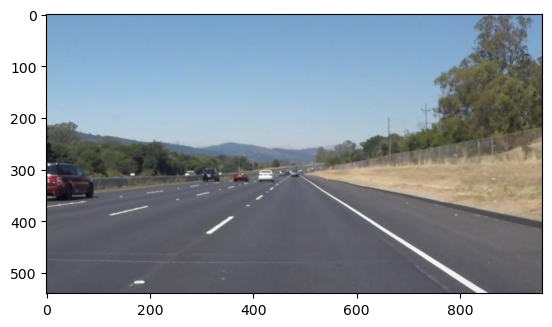

In [ ]:
url = 'https://raw.githubusercontent.com/AyushPanchal/cvip_project_data/refs/heads/main/test_images/solidWhiteRight.jpg'
with urllib.request.urlopen(url) as response:
    image = Image.open(response)
    image = np.array(image)

print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)
plt.show();

**Some OpenCV functions that might be useful for this project are:**

`cv2.inRange()` for color selection  
`cv2.fillPoly()` for regions selection  
`cv2.line()` to draw lines on an image given endpoints  
`cv2.addWeighted()` to coadd / overlay two images
`cv2.cvtColor()` to grayscale or change color
`cv2.imwrite()` to output images to file  
`cv2.bitwise_and()` to apply a mask to an image

Below are some helper functions to help get us started.

In [ ]:
def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.

    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    mask = np.zeros_like(img)

    if len(img.shape) > 2:
        channel_count = img.shape[2]  
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255

    cv2.fillPoly(mask, vertices, ignore_mask_color)

    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).

    Think about things like separating line segments by their
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of
    the lines and extrapolate to the top and bottom of the lane.

    This function draws `lines` with `color` and `thickness`.
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.

    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img


def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.

    `initial_img` should be the image before any processing.

    The result image is computed as follows:

    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

## Test on Images

Now we should build our pipeline to work on the images in the directory "test_images"  
**We should make sure our pipeline works well on these images before we try the videos.**

In [ ]:
os.listdir('data/test_images/')

['.DS_Store',
 'solidWhiteCurve.jpg',
 'solidWhiteRight.jpg',
 'solidYellowCurve.jpg',
 'solidYellowCurve2.jpg',
 'solidYellowLeft.jpg',
 'test1.jpg',
 'test2.jpg',
 'test3.jpg',
 'test4.jpg',
 'test5.jpg',
 'test6.jpg',
 'whiteCarLaneSwitch.jpg']

run your solution on all test_images and make copies into the test_images directory).

In [ ]:
def separate_lines(lines):
   #Separate Lines By +/- Slope
    right = []
    left = []
    for x1,y1,x2,y2 in lines[:, 0]:
        m = (float(y2) - y1) / (x2 - x1)
        if m >= 0:
            right.append([x1,y1,x2,y2,m])
        else:
            left.append([x1,y1,x2,y2,m])

    return right, left

def extend_point(x1, y1, x2, y2, length):
    line_len = np.sqrt((x1 - x2)**2 + (y1 - y2)**2)
    x = x2 + (x2 - x1) / line_len * length
    y = y2 + (y2 - y1) / line_len * length
    return x, y

def outliers(data, cutoff, thresh=0.08):

    data = np.array(data)
    data = data[(data[:, 4] >= cutoff[0]) & (data[:, 4] <= cutoff[1])]
    m = np.mean(data[:, 4], axis=0)
    return data[(data[:, 4] <= m+thresh) & (data[:, 4] >= m-thresh)]


def merge_lines(lines):
    # Merges And Extends Hough Detected Lines Across Image
    lines = np.array(lines)[:, :4]
    x1,y1,x2,y2 = np.mean(lines, axis=0)
    x1e, y1e = extend_point(x1,y1,x2,y2, -1000)
    x2e, y2e = extend_point(x1,y1,x2,y2, 1000)
    line = np.array([[x1e,y1e,x2e,y2e]])

    return np.array([line], dtype=np.int32)

def pipeline(image):
    # Paramemters For Region Selection
    bot_left = [80, 540]
    bot_right = [980, 540]
    apex_right = [510, 315]
    apex_left = [450, 315]
    v = [np.array([bot_left, bot_right, apex_right, apex_left], dtype=np.int32)]

    # Apply Canny Edge Detection And Mask Region Of Interest
    gray = grayscale(image)
    blur = gaussian_blur(gray, 7)
    edge = canny(blur, 50, 125)
    mask = region_of_interest(edge, v)

    # Apply Hough Lines
    lines = cv2.HoughLinesP(mask, 0.8, np.pi/180, 25, np.array([]), minLineLength=50, maxLineGap=200)
    # Separate Lines By Slope
    right_lines, left_lines = separate_lines(lines)


    right = outliers(right_lines,  cutoff=(0.45, 0.75))
    right = merge_lines(right)

    left = outliers(left_lines, cutoff=(-0.85, -0.6))
    left = merge_lines(left)

    lines = np.concatenate((right, left))

    # Draw Lines
    line_img = np.copy((image)*0)
    draw_lines(line_img, lines, thickness=10)
    #Compute Final Image
    line_img = region_of_interest(line_img, v)
    final = weighted_img(line_img, image)

    return final



## Test on Videos

You know what's cooler than drawing lanes over images? Drawing lanes over video!

We can test our solution on two provided videos:

`solidWhiteRight.mp4`

`solidYellowLeft.mp4`

In [ ]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
def process_image(image):

    result = pipeline(image)
    return result

Let's try the one with the solid white lane on the right first ...

In [10]:
white_output = 'data/final_white.mp4'
clip1 = VideoFileClip("data/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

Moviepy - Building video data/final_white.mp4.
Moviepy - Writing video data/final_white.mp4



Moviepy - Done !
Moviepy - video ready data/final_white.mp4
CPU times: total: 3.44 s
Wall time: 4.87 s


Play the video inline, or if you prefer find the video in your filesystem (should be in the same directory) and play it in your video player of choice.

In [ ]:
from IPython.display import HTML
from base64 import b64encode

# Load the video file
video_path = 'data/solidWhiteRight.mp4'
video_file = open(video_path, "rb").read()
video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"

# Display the video
HTML(f"""
<video width="960" height="540" controls>
  <source src="{video_url}" type="video/mp4">
</video>
""")

In [12]:
# Load the video file
video_path = 'data/final_white.mp4'
video_file = open(video_path, "rb").read()
video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"

# Display the video
HTML(f"""
<video width="960" height="540" controls>
  <source src="{video_url}" type="video/mp4">
</video>
""")

Now for the one with the solid yellow lane on the left. This one's more tricky!

In [13]:
yellow_output = 'data/final_yellow.mp4'
clip2 = VideoFileClip('data/solidYellowLeft.mp4')
yellow_clip = clip2.fl_image(process_image)
%time yellow_clip.write_videofile(yellow_output, audio=False)

Moviepy - Building video data/final_yellow.mp4.
Moviepy - Writing video data/final_yellow.mp4



Moviepy - Done !
Moviepy - video ready data/final_yellow.mp4
CPU times: total: 4.56 s
Wall time: 13.6 s


In [14]:
# Load the video file
video_path = 'data/solidYellowLeft.mp4'
video_file = open(video_path, "rb").read()
video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"

# Display the video
HTML(f"""
<video width="960" height="540" controls>
  <source src="{video_url}" type="video/mp4">
</video>
""")

In [15]:
# Load the video file
video_path = 'data/final_yellow.mp4'
video_file = open(video_path, "rb").read()
video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"

# Display the video
HTML(f"""
<video width="960" height="540" controls>
  <source src="{video_url}" type="video/mp4">
</video>
""")

## Challenges and Solutions
- **Varying light conditions:** Improved robustness using adaptive thresholding techniques and dynamic adjustment of detection parameters.
- **Curved roads and occluded vehicles:** Enhanced line detection algorithms to accommodate curvature and implemented more sophisticated object recognition models to identify partially visible vehicles.

## Results
The system successfully detects and tracks lane lines and vehicles with a high degree of accuracy in the provided test videos. Future improvements might include enhancing detection accuracy under extreme weather conditions and integrating more robust vehicle classification features.

## Conclusion
The "Finding Lane Lines on the Road" project underscores the potential of integrated computer vision techniques in advanced driver-assistance systems (ADAS), providing crucial technologies for the development of autonomous vehicles.